In [25]:
# UNet Pet Segmentation Evaluation
# Import necessary libraries
import os
import sys
import random
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from typing import Dict, List, Optional, Tuple, Union
from PIL import Image
from tqdm.notebook import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import cv2


# After the other imports, add:
# Define the SegmentationMetrics class
class SegmentationMetrics:
    def __init__(self, num_classes, ignore_index=255):
        self.num_classes = num_classes
        self.ignore_index = ignore_index
        self.reset()
        
    def reset(self):
        # Initialize accumulators for each class
        self.intersections = np.zeros(self.num_classes)
        self.unions = np.zeros(self.num_classes)
        self.true_positives = np.zeros(self.num_classes)
        self.false_positives = np.zeros(self.num_classes)
        self.false_negatives = np.zeros(self.num_classes)
        self.total_pixels = 0
        self.correct_pixels = 0
        
    def update(self, pred, target):
        """
        Update accumulators with a new batch of predictions and targets
        
        Args:
            pred: prediction tensor/array
            target: ground truth tensor/array
        """
        mask = (target != self.ignore_index)
        self.total_pixels += mask.sum()
        self.correct_pixels += ((pred == target) & mask).sum()
        
        # Update class-wise metrics
        for cls in range(self.num_classes):
            pred_cls = (pred == cls) & mask
            target_cls = (target == cls) & mask
            
            intersection = (pred_cls & target_cls).sum()
            union = (pred_cls | target_cls).sum()
            
            # Update accumulators
            self.intersections[cls] += intersection
            self.unions[cls] += union
            
            # For dice coefficient
            self.true_positives[cls] += intersection
            self.false_positives[cls] += pred_cls.sum() - intersection
            self.false_negatives[cls] += target_cls.sum() - intersection
            
    def compute_dice(self, cls):
        """
        Compute Dice coefficient for a specific class using accumulated statistics
        
        Args:
            cls: class index
            
        Returns:
            dice: Dice coefficient for the specified class
        """
        numerator = 2 * self.true_positives[cls]
        denominator = 2 * self.true_positives[cls] + self.false_positives[cls] + self.false_negatives[cls]
        
        if denominator > 0:
            return (numerator / denominator).item()
        return float('nan')
    
    def compute_pixel_accuracy(self):
        """
        Compute overall pixel accuracy using accumulated statistics
        
        Returns:
            accuracy: Pixel accuracy across the entire dataset
        """
        if self.total_pixels > 0:
            return (self.correct_pixels / self.total_pixels).item()
        return float('nan')
    
    def compute_iou(self, cls):
        """
        Compute IoU for a specific class using accumulated statistics
        
        Args:
            cls: class index
            
        Returns:
            iou: IoU for the specified class
        """
        if self.unions[cls] > 0:
            return (self.intersections[cls] / self.unions[cls]).item()
        return float('nan')
    
    def compute_mean_iou(self):
        """
        Compute mean IoU across all classes
        
        Returns:
            mean_iou: Mean IoU value
        """
        valid_ious = []
        for cls in range(self.num_classes):
            iou = self.compute_iou(cls)
            if not np.isnan(iou):
                valid_ious.append(iou)
        
        if valid_ious:
            return sum(valid_ious) / len(valid_ious)
        return float('nan')
    
    def compute_precision(self, cls):
        tp = self.true_positives[cls]
        fp = self.false_positives[cls]
        if (tp + fp) > 0:
            return (tp / (tp + fp)).item()
        return float('nan')

    def compute_recall(self, cls):
        tp = self.true_positives[cls]
        fn = self.false_negatives[cls]
        if (tp + fn) > 0:
            return (tp / (tp + fn)).item()
        return float('nan')


Using device: cuda
Loading model from /home/ulixes/segmentation_cv/unet/models/unet_pet_segmentation/best_model.pth
Model loaded successfully
Test dataset size: 3694 images
Evaluating on random batches...


### Random Batch 1/5 ###
Prediction Visualization:


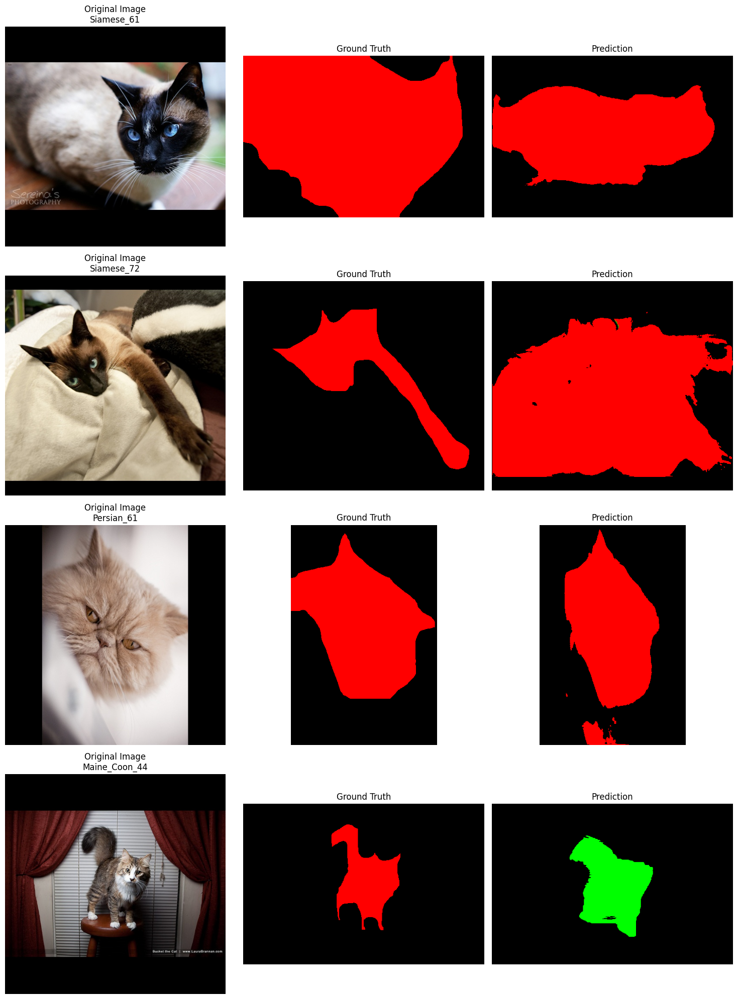


Batch Metrics:
Pixel Accuracy: 0.7383
Mean IoU: 0.3850

Class-wise Metrics:
Background - IoU: 0.6736, Dice: 0.8050
Cat - IoU: 0.4815, Dice: 0.6500
Dog - IoU: 0.0000, Dice: 0.0000

Mean Foreground Dice: 0.3250

Error Analysis:


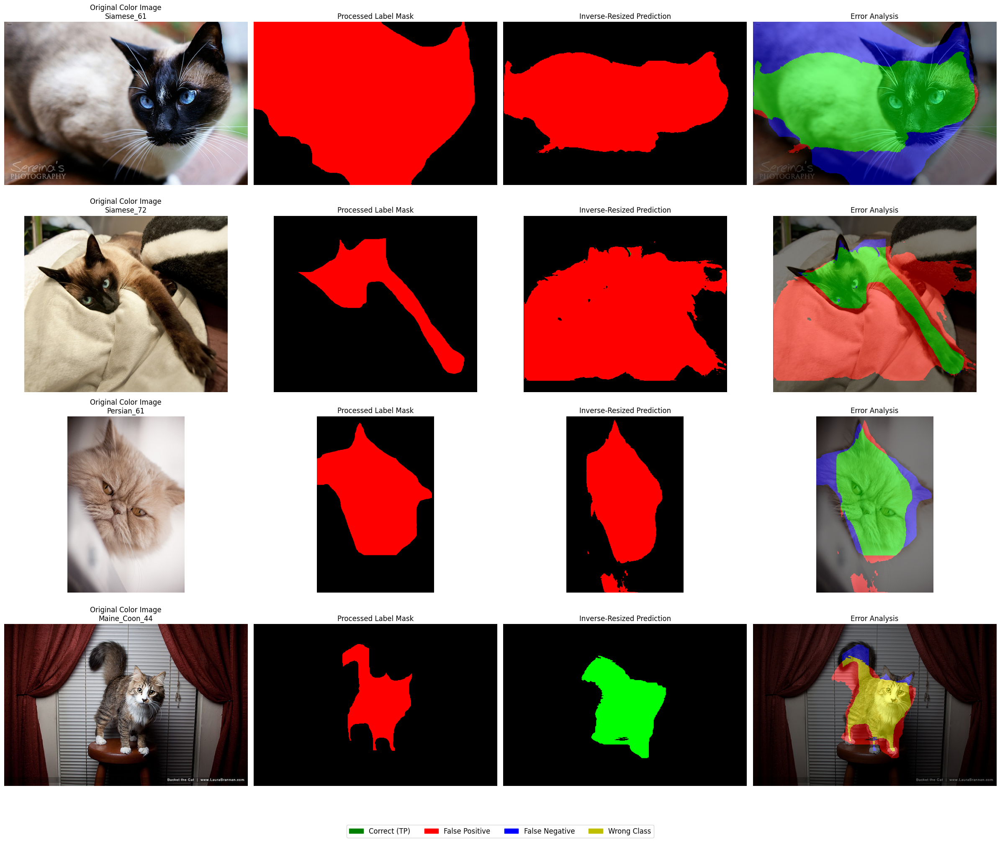



### Random Batch 2/5 ###
Prediction Visualization:


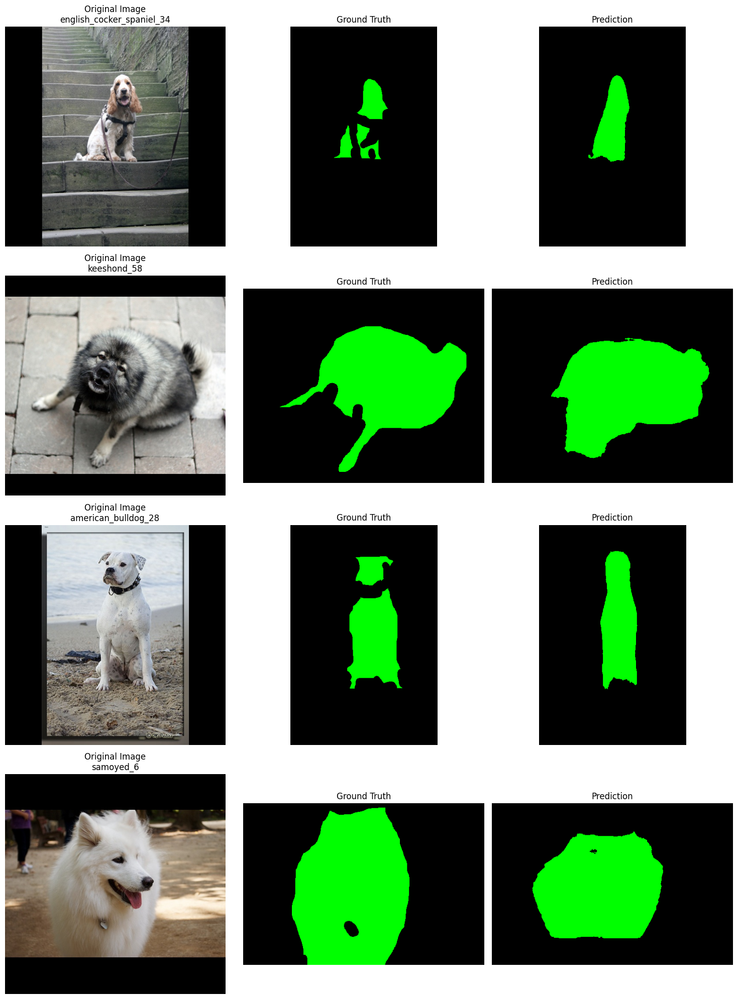


Batch Metrics:
Pixel Accuracy: 0.9380
Mean IoU: 0.8314

Class-wise Metrics:
Background - IoU: 0.9249, Dice: 0.9610
Cat - IoU: nan, Dice: nan
Dog - IoU: 0.7380, Dice: 0.8493

Mean Foreground Dice: 0.8493

Error Analysis:


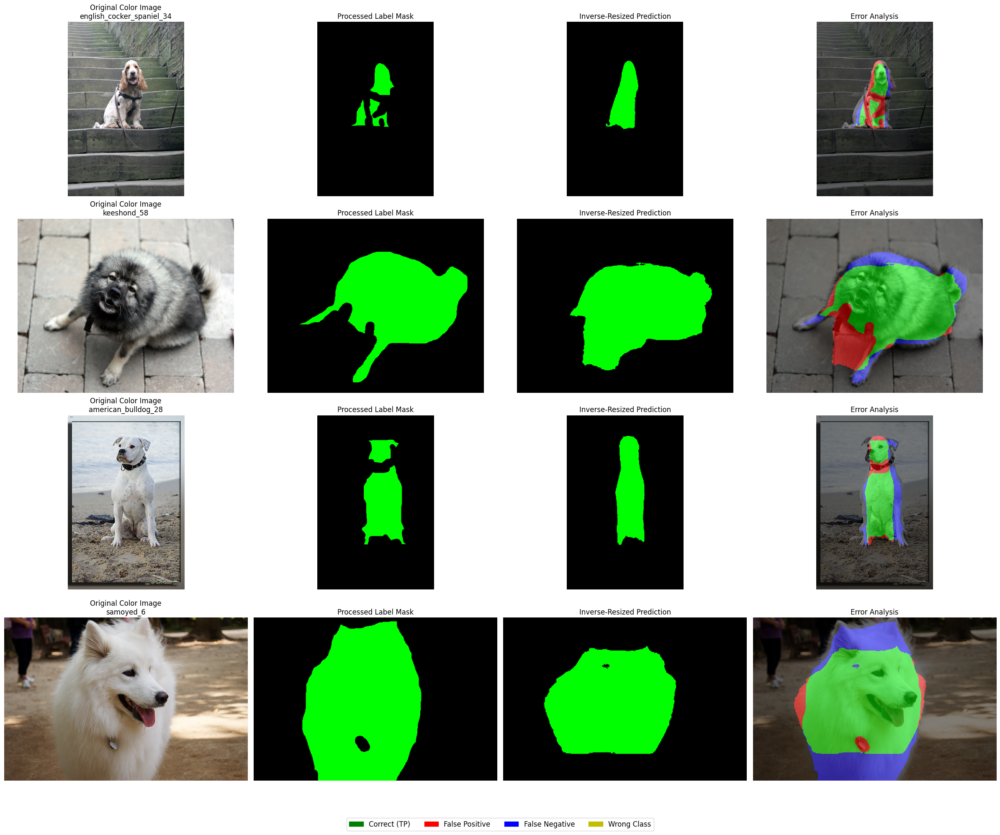



### Random Batch 3/5 ###
Prediction Visualization:


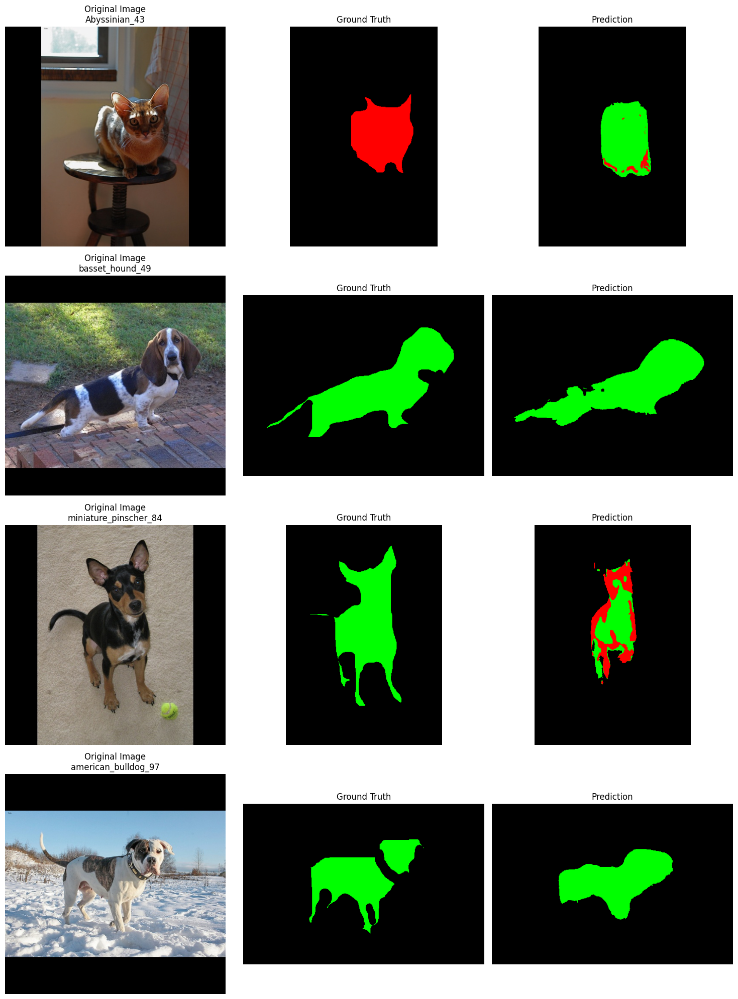


Batch Metrics:
Pixel Accuracy: 0.9227
Mean IoU: 0.4875

Class-wise Metrics:
Background - IoU: 0.9512, Dice: 0.9750
Cat - IoU: 0.0219, Dice: 0.0429
Dog - IoU: 0.4895, Dice: 0.6573

Mean Foreground Dice: 0.3501

Error Analysis:


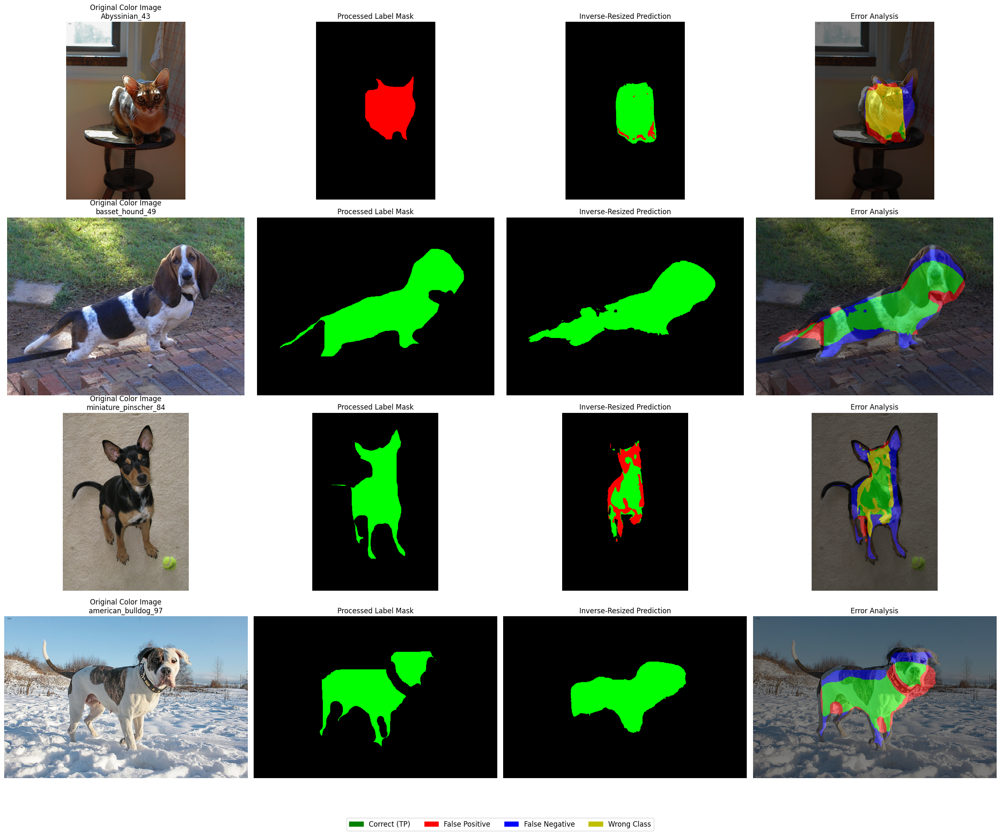



### Random Batch 4/5 ###
Prediction Visualization:


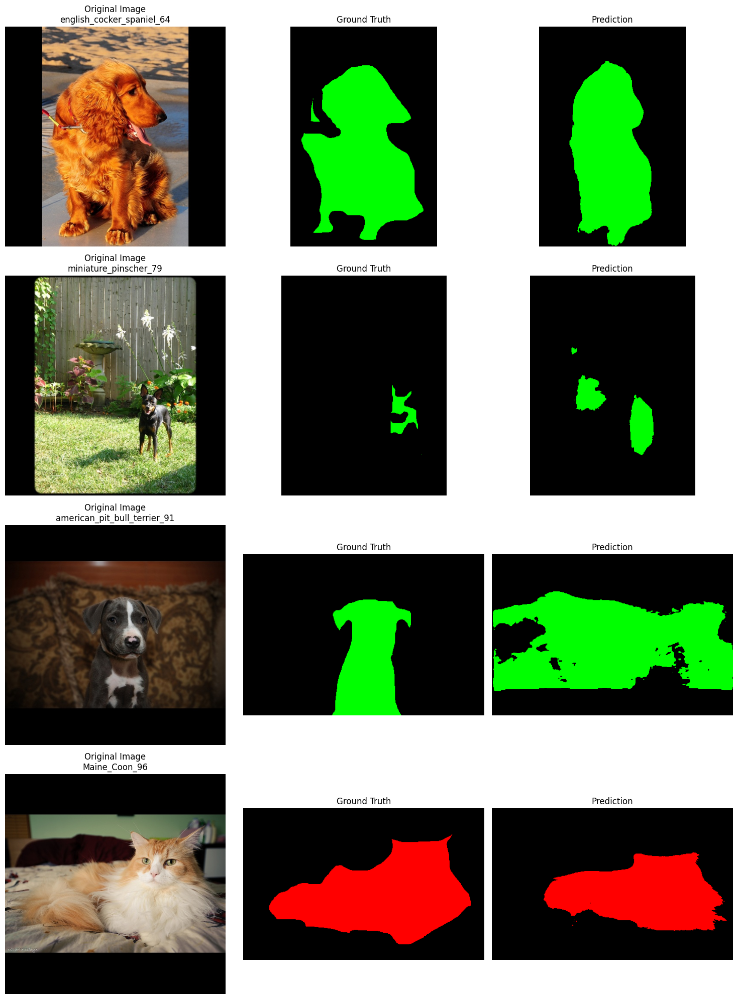


Batch Metrics:
Pixel Accuracy: 0.8427
Mean IoU: 0.6645

Class-wise Metrics:
Background - IoU: 0.8081, Dice: 0.8939
Cat - IoU: 0.7138, Dice: 0.8330
Dog - IoU: 0.4714, Dice: 0.6408

Mean Foreground Dice: 0.7369

Error Analysis:


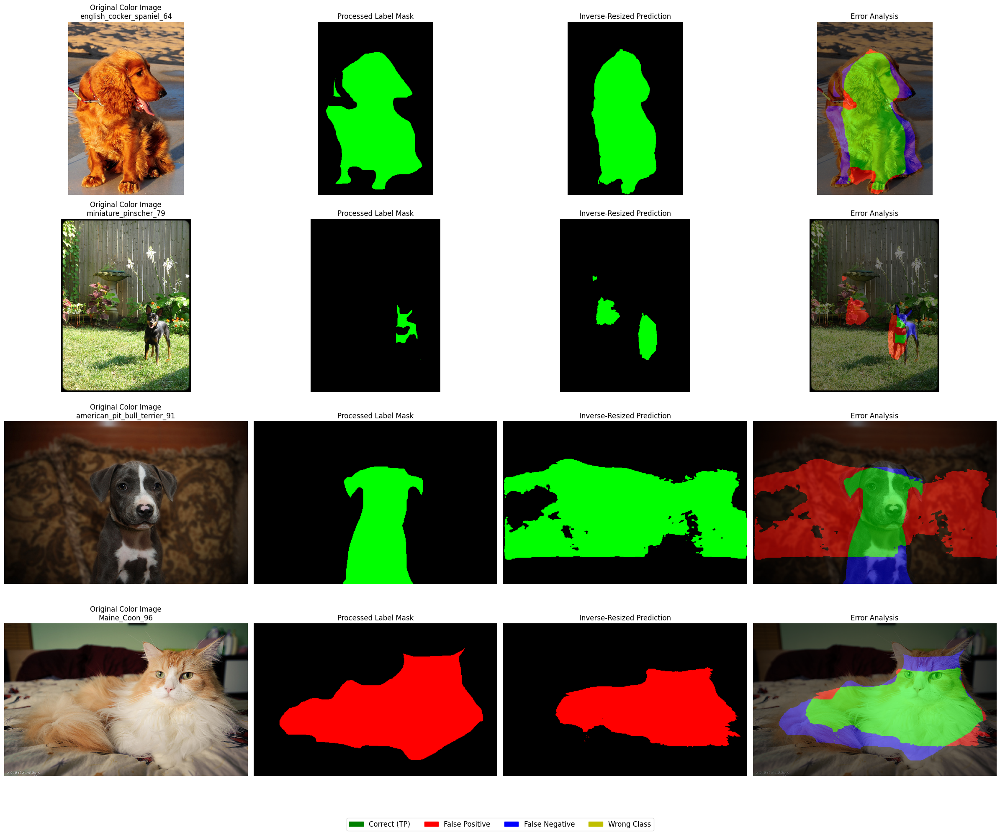



### Random Batch 5/5 ###
Prediction Visualization:


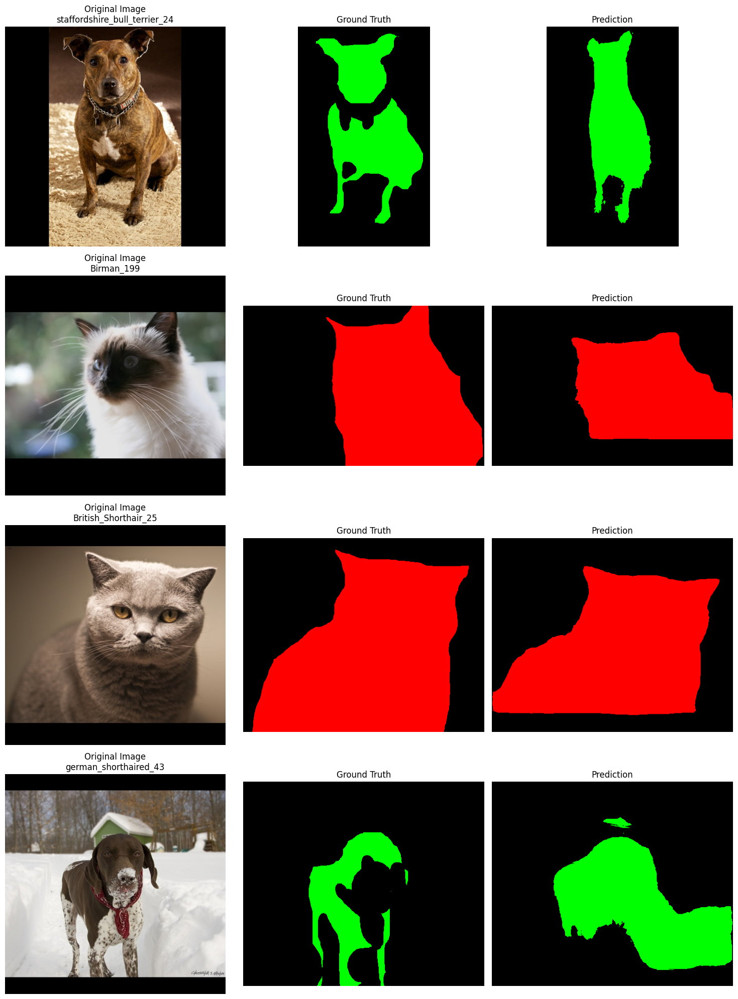


Batch Metrics:
Pixel Accuracy: 0.8357
Mean IoU: 0.6550

Class-wise Metrics:
Background - IoU: 0.7644, Dice: 0.8665
Cat - IoU: 0.7398, Dice: 0.8505
Dog - IoU: 0.4607, Dice: 0.6308

Mean Foreground Dice: 0.7406

Error Analysis:


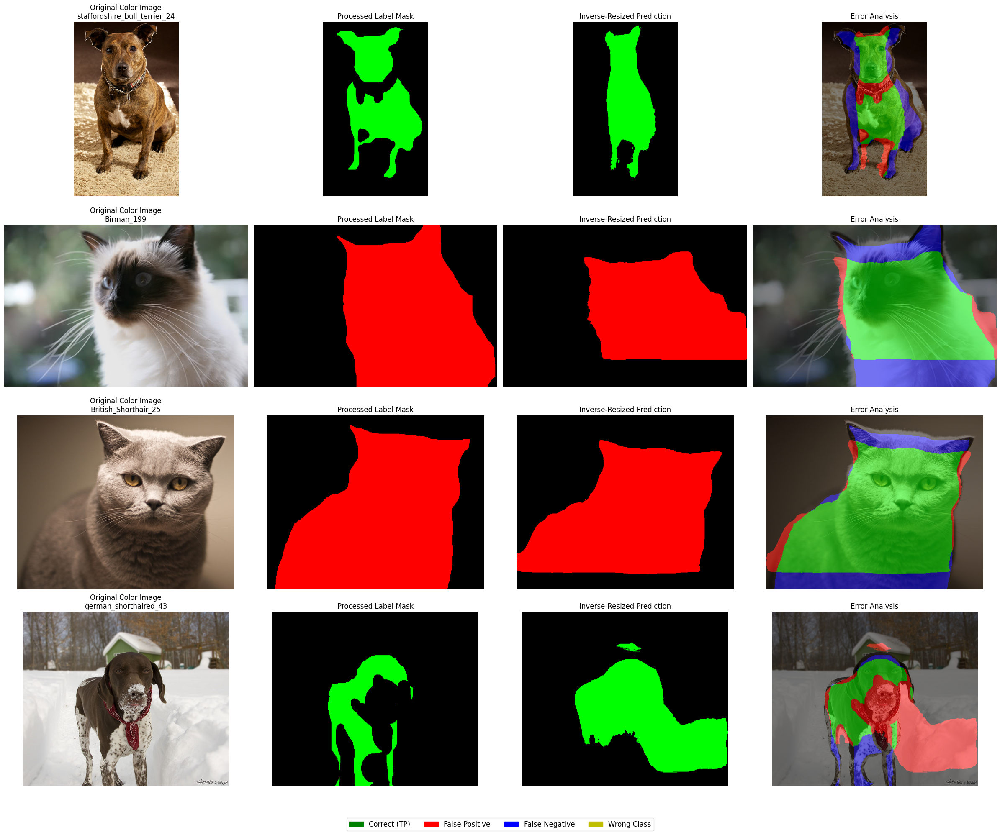



### Overall Metrics ###
Pixel Accuracy: 0.8556
Mean IoU: 0.6465

Class-wise Metrics:
Background - IoU: 0.8322, Dice: 0.9084
Cat - IoU: 0.5683, Dice: 0.7247
Dog - IoU: 0.5390, Dice: 0.7004

Mean Foreground Dice: 0.7126

Evaluation complete!


In [26]:

# Set up base directories - modify these paths to match your system
BASE_DIR = Path('/home/ulixes/segmentation_cv/unet')
DATA_DIR = BASE_DIR / 'data/processed'
MODEL_PATH = BASE_DIR / 'models/unet_pet_segmentation/best_model.pth'
OUTPUT_DIR = BASE_DIR / 'evaluation_results'

# Add the project root to the Python path so we can import local modules
if str(BASE_DIR) not in sys.path:
    sys.path.append(str(BASE_DIR))

# Import UNet model and SegmentationMetrics after adding to path
from src.models.unet import UNet

# Create output directory
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)
PRED_MASK_DIR = OUTPUT_DIR / 'predictions'
PRED_MASK_DIR.mkdir(parents=True, exist_ok=True)

# Test data paths
TEST_IMG_DIR = DATA_DIR / 'Test/resized'
TEST_MASK_DIR = DATA_DIR / 'Test/processed_labels'
ORIGINAL_IMG_DIR = DATA_DIR / 'Test/color'

# Set batch size and other parameters
BATCH_SIZE = 4
NUM_WORKERS = 4
TARGET_SIZE = (512, 512)
NUM_CLASSES = 3  # Background, Cat, Dog

# Define the PetSegmentationDataset class
class PetSegmentationDataset(Dataset):
    """Dataset class for the Oxford-IIIT Pet segmentation dataset."""
    
    def __init__(
        self,
        images_dir: str,
        masks_dir: str,
        include_augmented: bool = False,
        target_size: Tuple[int, int] = (512, 512)
    ):
        """
        Initialize the dataset.
        
        Args:
            images_dir: Directory containing images
            masks_dir: Directory containing mask annotations
            include_augmented: Whether to include augmented images (if available)
            target_size: Target size for images and masks (height, width)
        """
        self.images_dir = Path(images_dir)
        self.masks_dir = Path(masks_dir)
        self.target_size = target_size
        
        # Get all image files from the directory
        self.image_files = sorted(list(self.images_dir.glob("*.jpg")))
        if not self.image_files:
            self.image_files = sorted(list(self.images_dir.glob("*.png")))
        
        # Check for augmented data directory
        if include_augmented and (self.images_dir.parent / "augmented" / "images").exists():
            aug_images_dir = self.images_dir.parent / "augmented" / "images"
            aug_masks_dir = self.images_dir.parent / "augmented" / "masks"
            
            # Add augmented images to the dataset
            aug_image_files = sorted(list(aug_images_dir.glob("*.jpg")))
            if not aug_image_files:
                aug_image_files = sorted(list(aug_images_dir.glob("*.png")))
                
            self.aug_image_files = aug_image_files
            self.aug_masks_dir = aug_masks_dir
            
            self.image_files.extend(aug_image_files)
        else:
            self.aug_image_files = []
            self.aug_masks_dir = None
    
    def __len__(self) -> int:
        """Return the number of samples in the dataset."""
        return len(self.image_files)
    
    def __getitem__(self, idx: int) -> Dict[str, torch.Tensor]:
        """
        Get a sample from the dataset.
        
        Args:
            idx: Index of the sample to retrieve
            
        Returns:
            Dict containing image and mask tensors
        """
        # Get image file path
        img_path = self.image_files[idx]
        
        # Determine if this is an augmented image
        is_augmented = img_path in self.aug_image_files if self.aug_image_files else False
        
        # Get corresponding mask file path
        if is_augmented and self.aug_masks_dir:
            mask_path = self.aug_masks_dir / f"{img_path.stem}.png"
        else:
            mask_path = self.masks_dir / f"{img_path.stem}.png"
        
        # Load image and mask
        try:
            image = cv2.imread(str(img_path))
            if image is None:
                raise ValueError(f"Failed to load image: {img_path}")
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
            if mask is None:
                raise ValueError(f"Failed to load mask: {mask_path}")
                
            # Store original dimensions before resizing
            original_dims = mask.shape[:2]  # (height, width)
        except Exception as e:
            print(f"Error loading image or mask: {e}")
            # Return a blank sample as fallback
            image = np.zeros((self.target_size[0], self.target_size[1], 3), dtype=np.uint8)
            mask = np.zeros(self.target_size, dtype=np.uint8)
            original_dims = self.target_size
        
        # Ensure image and mask have the correct dimensions
        if image.shape[:2] != self.target_size:
            image = cv2.resize(image, (self.target_size[1], self.target_size[0]), interpolation=cv2.INTER_LINEAR)
        
        if mask.shape != self.target_size:
            mask = cv2.resize(mask, (self.target_size[1], self.target_size[0]), interpolation=cv2.INTER_NEAREST)
        
        # Keep 255 as is - we'll handle it properly in the loss function
        # Just ensure other values are within valid range (0, 1, 2)
        mask = np.where((mask > 2) & (mask != 255), 0, mask)
        
        # Convert image to tensor and normalize (0-1)
        image = torch.from_numpy(image).float().permute(2, 0, 1) / 255.0
        
        # Apply standardization (approximately equivalent to ImageNet normalization)
        mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
        std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
        image = (image - mean) / std
        
        # Convert mask to tensor
        mask = torch.from_numpy(mask).long()
        
        # Store original dimensions as tensor
        original_dims = torch.tensor(original_dims)
        
        return {
            "image": image, 
            "mask": mask,
            "original_dims": original_dims,
            "filename": img_path.stem
        }

# Load model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

def load_model(model_path: str, device: torch.device) -> nn.Module:
    """Load the trained UNet model from a checkpoint."""
    # Create model
    model = UNet(
        in_channels=3,
        num_classes=3,
        n_stages=6,
        features_per_stage=[32, 64, 128, 256, 512, 512],
        kernel_sizes=[[3, 3]] * 6,
        strides=[[1, 1], [2, 2], [2, 2], [2, 2], [2, 2], [2, 2]],
        n_conv_per_stage=[2] * 6,
        n_conv_per_stage_decoder=[2] * 5,
        conv_bias=True,
        norm_op=nn.InstanceNorm2d,
        norm_op_kwargs={"eps": 1e-5, "affine": True},
        dropout_op=None,
        nonlin=nn.LeakyReLU,
        nonlin_kwargs={"inplace": True},
        encoder_dropout_rates=[0.0, 0.0, 0.1, 0.2, 0.3, 0.3],
        decoder_dropout_rates=[0.3, 0.2, 0.2, 0.1, 0.0]
    )
    
    # Load checkpoint
    checkpoint = torch.load(model_path, map_location=device)
    
    # Load state dict - handle both formats (just state_dict or full checkpoint)
    if "model_state_dict" in checkpoint:
        model.load_state_dict(checkpoint["model_state_dict"])
    else:
        model.load_state_dict(checkpoint)
    
    # Move to device and set to evaluation mode
    model = model.to(device)
    model.eval()
    
    return model

# Load the model
print(f"Loading model from {MODEL_PATH}")
model = load_model(MODEL_PATH, device)
print("Model loaded successfully")

# Create test dataset
test_dataset = PetSegmentationDataset(
    images_dir=TEST_IMG_DIR,
    masks_dir=TEST_MASK_DIR,
    include_augmented=False,
    target_size=TARGET_SIZE
)
print(f"Test dataset size: {len(test_dataset)} images")

# Create dataloader with shuffling to get random batches
test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,  # Shuffle to get random batches
    num_workers=NUM_WORKERS,
    pin_memory=True
)

# Define function to colorize masks
def colorize_mask(mask: np.ndarray) -> np.ndarray:
    """
    Convert a segmentation mask with values {0,1,2} into an RGB color image.
    - 0 → black (0, 0, 0)
    - 1 → red (255, 0, 0) for cats
    - 2 → green (0, 255, 0) for dogs
    """
    rgb_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)
    rgb_mask[mask == 1] = [255, 0, 0]  # Red for class 1 (cat)
    rgb_mask[mask == 2] = [0, 255, 0]  # Green for class 2 (dog)
    return rgb_mask

# Function to predict and visualize a batch
def predict_and_visualize_batch(model, batch, device):
    """Predict and visualize a batch of images."""
    images = batch["image"].to(device)
    masks = batch["mask"].to(device)
    original_dims = batch["original_dims"]
    filenames = batch["filename"]
    
    # Forward pass
    with torch.no_grad():
        outputs = model(images)
    
    # Get predictions
    preds = torch.argmax(outputs, dim=1)
    
    # Initialize metrics for this batch
    batch_metrics = SegmentationMetrics(num_classes=3, ignore_index=255)
    
    # Process each prediction
    fig, axes = plt.subplots(len(filenames), 3, figsize=(15, 5*len(filenames)))
    if len(filenames) == 1:  # Handle single image case
        axes = axes.reshape(1, -1)
    
    for i in range(len(filenames)):
        # Get original dimensions
        orig_h, orig_w = original_dims[i]
        
        # Resize prediction to original dimensions
        pred_resized = F.interpolate(
            preds[i][None, None].float(),
            size=(orig_h, orig_w),
            mode="nearest"
        ).squeeze().cpu().numpy().astype(np.uint8)
        
        # Resize mask to original dimensions
        mask_resized = F.interpolate(
            masks[i][None, None].float(),
            size=(orig_h, orig_w),
            mode="nearest"
        ).squeeze().cpu().numpy().astype(np.uint8)
        
        # Update metrics
        batch_metrics.update(pred_resized, mask_resized)
        
        # Prepare image for visualization
        img = images[i].cpu().permute(1, 2, 0).numpy()
        
        # Denormalize image
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        img = img * std + mean
        img = np.clip(img, 0, 1)
        
        # Colorize masks
        colored_gt = colorize_mask(mask_resized)
        colored_pred = colorize_mask(pred_resized)
        
        # Display images
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"Original Image\n{filenames[i]}")
        axes[i, 0].axis("off")
        
        axes[i, 1].imshow(colored_gt)
        axes[i, 1].set_title(f"Ground Truth")
        axes[i, 1].axis("off")
        
        axes[i, 2].imshow(colored_pred)
        axes[i, 2].set_title(f"Prediction")
        axes[i, 2].axis("off")
    
    plt.tight_layout()
    plt.show()
    
    # Print metrics for this batch
    print("\nBatch Metrics:")
    print(f"Pixel Accuracy: {batch_metrics.compute_pixel_accuracy():.4f}")
    print(f"Mean IoU: {batch_metrics.compute_mean_iou():.4f}")
    
    print("\nClass-wise Metrics:")
    print(f"Background - IoU: {batch_metrics.compute_iou(0):.4f}, Dice: {batch_metrics.compute_dice(0):.4f}")
    print(f"Cat - IoU: {batch_metrics.compute_iou(1):.4f}, Dice: {batch_metrics.compute_dice(1):.4f}")
    print(f"Dog - IoU: {batch_metrics.compute_iou(2):.4f}, Dice: {batch_metrics.compute_dice(2):.4f}")
    
    mean_foreground_dice = np.nanmean([batch_metrics.compute_dice(1), batch_metrics.compute_dice(2)])
    print(f"\nMean Foreground Dice: {mean_foreground_dice:.4f}")
    
    return batch_metrics

# Create error visualization function
def create_error_visualization(pred_mask, gt_mask, original_image_path):
    """
    Create an error visualization that accurately represents segmentation errors
    
    Args:
    pred_mask: Predicted segmentation mask
    gt_mask: Ground truth segmentation mask
    original_image_path: Path to the original image (for dimensions)
    
    Returns:
    Blended error visualization
    """
    # Load the original image
    original_image = cv2.imread(original_image_path)
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    
    # Create error map on original image dimensions
    error_map = np.zeros((original_image.shape[0], original_image.shape[1], 3), dtype=np.uint8)
    
    # Modify masks to treat 255 as background (0)
    pred_mask_processed = pred_mask.copy()
    gt_mask_processed = gt_mask.copy()
    pred_mask_processed[pred_mask_processed == 255] = 0
    gt_mask_processed[gt_mask_processed == 255] = 0
    
    # Compute error categories with more precise definitions
    # True Positive: Pixels correctly predicted for non-background classes
    true_positive = (pred_mask_processed > 0) & (gt_mask_processed > 0) & (pred_mask_processed == gt_mask_processed)
    
    # False Positive: Pixels predicted as an object where no object exists
    false_positive = (pred_mask_processed > 0) & (gt_mask_processed == 0)
    
    # False Negative: Pixels that are objects in ground truth but not predicted
    false_negative = (pred_mask_processed == 0) & (gt_mask_processed > 0)
    
    # Wrong Class: Pixels where an object is predicted, but with the wrong class
    wrong_class = (pred_mask_processed > 0) & (gt_mask_processed > 0) & (pred_mask_processed != gt_mask_processed)
    
    # Color code error categories
    error_map[true_positive] = [0, 255, 0]    # Green for true positives
    error_map[false_positive] = [255, 0, 0]   # Red for false positives
    error_map[false_negative] = [0, 0, 255]   # Blue for false negatives
    error_map[wrong_class] = [255, 255, 0]    # Yellow for wrong class predictions
    
    # Blend error map with original image
    alpha = 0.5
    blended = (original_image * (1 - alpha) + error_map * alpha).astype(np.uint8)
    
    return blended

# Function to show error analysis for a batch
def visualize_error_analysis_batch(model, batch, device):
    """Visualize error analysis for a batch of images."""
    images = batch["image"].to(device)
    masks = batch["mask"].to(device)
    original_dims = batch["original_dims"]
    filenames = batch["filename"]
    
    # Forward pass
    with torch.no_grad():
        outputs = model(images)
    
    # Get predictions
    preds = torch.argmax(outputs, dim=1)
    
    # Process each prediction
    fig, axes = plt.subplots(len(filenames), 4, figsize=(24, 5*len(filenames)))
    if len(filenames) == 1:  # Handle single image case
        axes = axes.reshape(1, -1)
    
    for i in range(len(filenames)):
        # Get original dimensions and convert to Python integers
        orig_h = int(original_dims[i][0].item())
        orig_w = int(original_dims[i][1].item())        

        # Resize prediction to original dimensions
        pred_resized = F.interpolate(
            preds[i][None, None].float(),
            size=(orig_h, orig_w),
            mode="nearest"
        ).squeeze().cpu().numpy().astype(np.uint8)
        
        # Resize mask to original dimensions
        mask_resized = F.interpolate(
            masks[i][None, None].float(),
            size=(orig_h, orig_w),
            mode="nearest"
        ).squeeze().cpu().numpy().astype(np.uint8)
        
        # Load the original color image
        original_image_path = os.path.join(ORIGINAL_IMG_DIR, f"{filenames[i]}.jpg")
        original_image = cv2.imread(original_image_path)
        original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
        original_image = cv2.resize(original_image, (orig_w, orig_h), interpolation=cv2.INTER_LINEAR)
        
        # Prepare processed label mask similar to how masks are processed in prediction visualization
        processed_label_path = os.path.join(TEST_MASK_DIR, f"{filenames[i]}.png")
        processed_label = cv2.imread(processed_label_path, cv2.IMREAD_GRAYSCALE)
        
        # Ensure processed label matches dimensions and processing of mask
        processed_label = np.where((processed_label > 2) & (processed_label != 255), 0, processed_label)
        processed_label_resized = cv2.resize(processed_label, (orig_w, orig_h), interpolation=cv2.INTER_NEAREST)
        
        # Colorize masks (use the same colorization as in prediction visualization)
        colored_processed_label = colorize_mask(processed_label_resized)
        colored_pred = colorize_mask(pred_resized)
        
        # Create error visualization
        error_viz = create_error_visualization(
            pred_resized, 
            mask_resized, 
            original_image_path
        )
        
        # Display images
        axes[i, 0].imshow(original_image)
        axes[i, 0].set_title(f"Original Color Image\n{filenames[i]}")
        axes[i, 0].axis("off")
        
        axes[i, 1].imshow(colored_processed_label)
        axes[i, 1].set_title(f"Processed Label Mask")
        axes[i, 1].axis("off")
        
        axes[i, 2].imshow(colored_pred)
        axes[i, 2].set_title(f"Inverse-Resized Prediction")
        axes[i, 2].axis("off")
        
        axes[i, 3].imshow(error_viz)
        axes[i, 3].set_title(f"Error Analysis")
        axes[i, 3].axis("off")
    
    # Add legend to the last row
    legend_items = [
        plt.Rectangle((0, 0), 1, 1, color='g', label='Correct (TP)'),
        plt.Rectangle((0, 0), 1, 1, color='r', label='False Positive'),
        plt.Rectangle((0, 0), 1, 1, color='b', label='False Negative'),
        plt.Rectangle((0, 0), 1, 1, color='y', label='Wrong Class')
    ]
    
    fig.legend(
        handles=legend_items,
        loc='lower center',
        bbox_to_anchor=(0.5, 0),
        ncol=4,
        fontsize='large'
    )
    
    plt.tight_layout(rect=(0, 0.05, 1, 1))  # Adjust layout to make room for legend
    plt.show()

# Evaluate on random batches
print("Evaluating on random batches...")

# Initialize overall metrics
overall_metrics = SegmentationMetrics(num_classes=3, ignore_index=255)

# Number of random batches to evaluate
num_batches = 5  # Change this to evaluate more or fewer batches

# Track which batches we've seen to avoid duplicates
seen_batches = set()

# Evaluate and visualize random batches
batch_iterator = iter(test_loader)
for i in range(num_batches):
    try:
        batch = next(batch_iterator)
    except StopIteration:
        # Recreate iterator if we run out of batches
        batch_iterator = iter(test_loader)
        batch = next(batch_iterator)
    
    # Generate a batch ID based on filenames to avoid duplicates
    batch_id = '-'.join(sorted(batch["filename"]))
    if batch_id in seen_batches:
        continue
    seen_batches.add(batch_id)
    
    print(f"\n\n### Random Batch {i+1}/{num_batches} ###")
    
    # Visualize batch predictions
    print("Prediction Visualization:")
    batch_metrics = predict_and_visualize_batch(model, batch, device)
    
    # Visualize error analysis
    print("\nError Analysis:")
    visualize_error_analysis_batch(model, batch, device)
    
    # Update overall metrics
    images = batch["image"].to(device)
    masks = batch["mask"].to(device)
    original_dims = batch["original_dims"]
    
    with torch.no_grad():
        outputs = model(images)
        preds = torch.argmax(outputs, dim=1)
        
        for j in range(len(batch["filename"])):
            orig_h, orig_w = original_dims[j]
            
            # Resize prediction to original dimensions
            pred_resized = F.interpolate(
                preds[j][None, None].float(),
                size=(orig_h, orig_w),
                mode="nearest"
            ).squeeze().cpu().numpy().astype(np.uint8)
            
            # Resize mask to original dimensions
            mask_resized = F.interpolate(
                masks[j][None, None].float(),
                size=(orig_h, orig_w),
                mode="nearest"
            ).squeeze().cpu().numpy().astype(np.uint8)
            
            overall_metrics.update(pred_resized, mask_resized)

# Print overall metrics after evaluating all batches
print("\n\n### Overall Metrics ###")
print(f"Pixel Accuracy: {overall_metrics.compute_pixel_accuracy():.4f}")
print(f"Mean IoU: {overall_metrics.compute_mean_iou():.4f}")

print("\nClass-wise Metrics:")
print(f"Background - IoU: {overall_metrics.compute_iou(0):.4f}, Dice: {overall_metrics.compute_dice(0):.4f}")
print(f"Cat - IoU: {overall_metrics.compute_iou(1):.4f}, Dice: {overall_metrics.compute_dice(1):.4f}")
print(f"Dog - IoU: {overall_metrics.compute_iou(2):.4f}, Dice: {overall_metrics.compute_dice(2):.4f}")

mean_foreground_dice = np.nanmean([overall_metrics.compute_dice(1), overall_metrics.compute_dice(2)])
print(f"\nMean Foreground Dice: {mean_foreground_dice:.4f}")

# Evaluate full test set (optional)
def evaluate_full_test_set():
    """Evaluate the model on the full test set."""
    print("\n### Evaluating on full test set ###")
    
    # Create a new dataloader without shuffling
    full_test_loader = DataLoader(
        test_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=NUM_WORKERS,
        pin_memory=True
    )
    
    # Initialize metrics
    full_metrics = SegmentationMetrics(num_classes=3, ignore_index=255)
    
    # Evaluate all batches
    with torch.no_grad():
        for batch in tqdm(full_test_loader, desc="Evaluating full test set"):
            images = batch["image"].to(device)
            masks = batch["mask"].to(device)
            original_dims = batch["original_dims"]
            
            # Forward pass
            outputs = model(images)
            preds = torch.argmax(outputs, dim=1)
            
            # Process each prediction
            for i in range(images.size(0)):
                orig_h, orig_w = original_dims[i]
                
                # Resize prediction to original dimensions
                pred_resized = F.interpolate(
                    preds[i][None, None].float(),
                    size=(orig_h, orig_w),
                    mode="nearest"
                ).squeeze().cpu().numpy().astype(np.uint8)
                
                # Resize mask to original dimensions
                mask_resized = F.interpolate(
                    masks[i][None, None].float(),
                    size=(orig_h, orig_w),
                    mode="nearest"
                ).squeeze().cpu().numpy().astype(np.uint8)
                
                # Update metrics
                full_metrics.update(pred_resized, mask_resized)
    
    # Print full test set metrics
    print("\n### Full Test Set Metrics ###")
    print(f"Pixel Accuracy: {full_metrics.compute_pixel_accuracy():.4f}")
    print(f"Mean IoU: {full_metrics.compute_mean_iou():.4f}")
    
    print("\nClass-wise Metrics:")
    print(f"Background - IoU: {full_metrics.compute_iou(0):.4f}, Dice: {full_metrics.compute_dice(0):.4f}")
    print(f"Cat - IoU: {full_metrics.compute_iou(1):.4f}, Dice: {full_metrics.compute_dice(1):.4f}")
    print(f"Dog - IoU: {full_metrics.compute_iou(2):.4f}, Dice: {full_metrics.compute_dice(2):.4f}")
    
    mean_foreground_dice = np.nanmean([full_metrics.compute_dice(1), full_metrics.compute_dice(2)])
    print(f"\nMean Foreground Dice: {mean_foreground_dice:.4f}")
    for cls_name, cls_id in zip(["Background", "Cat", "Dog"], [0, 1, 2]):
        precision = full_metrics.compute_precision(cls_id)
        recall = full_metrics.compute_recall(cls_id)
        iou = full_metrics.compute_iou(cls_id)
        dice = full_metrics.compute_dice(cls_id)
        print(f"{cls_name:<10} | Precision: {precision:.4f} | Recall: {recall:.4f} | IoU: {iou:.4f} | Dice: {dice:.4f}")

    return full_metrics

# Uncomment to evaluate full test set
# full_test_metrics = evaluate_full_test_set()

print("\nEvaluation complete!")